# Project  1  - Weather prediction 

In [1]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn import linear_model

from matplotlib import pyplot as plt
plt.rcParams["animation.html"] = "jshtml" 
%matplotlib inline
from pprint import pprint
from sklearn.model_selection import train_test_split
from sklearn.linear_model import BayesianRidge

### import dodanie targeta 

In [2]:
benijng = pd.read_csv("data/BeijingPM20100101_20151231.csv")
benijng['city'] = "benijng"
#chengdu = pd.read_csv("ChengduPM20100101_20151231.csv")
#chengdu['city'] = "chengdu"
#guanggzhou = pd.read_csv("GuangzhouPM20100101_20151231.csv")
#guanggzhou['city'] = "guanggzhou"
#shanghai = pd.read_csv("ShanghaiPM20100101_20151231.csv")
#shanghai['city'] = 'shanghai'
#shenyang = pd.read_csv("ShenyangPM20100101_20151231.csv")
#shenyang['city'] = "shenyang"



In [3]:
print(benijng.head(1))


   No  year  month  day  hour  season  PM_Dongsi  PM_Dongsihuan  \
0   1  2010      1    1     0       4        NaN            NaN   

   PM_Nongzhanguan  PM_US Post  DEWP  HUMI    PRES  TEMP cbwd   Iws  \
0              NaN         NaN -21.0  43.0  1021.0 -11.0   NW  1.79   

   precipitation  Iprec     city  
0            0.0    0.0  benijng  


In [4]:
#all_cities = pd.concat([benijng, chengdu, guanggzhou, shanghai, shenyang], axis=0)
#all_cities.head(5)


In [5]:
print(len(benijng))


52584


In [7]:
#len(all_cities)

In [8]:
profile = ProfileReport(benijng)
profile.to_notebook_iframe()

# Bayesian MODELS


In [9]:
from matplotlib.animation import FuncAnimation

class UpdateBayesianLinearRegression:
    '''Pomocnicza klasa do inkrementalnego uczenia'''
    def __init__(
        self,
        ax,
        model,
        X_test_with_cat,
        y_test,
        x_idx,
        x_label,
        y_label,
        category_idx=None,
        interval=0.95
    ):
        self.ax = ax
        self.model = model
        self.x_idx = x_idx
        
        self.interval = interval
        
        self.mean, = ax.plot([], [], color="red", label="Mean output")
        self.credible_interval = ax.fill_between(
            [],
            [],
            [],
            color='cornflowerblue',
            alpha=0.5,
            label=f"Credible Interval"
        )
        self.num_samples = ax.text(0.5, 1, '', fontsize=15, horizontalalignment='right',
                                   verticalalignment='bottom', transform=ax.transAxes)
        self.ratio_in_interval = ax.text(1, 0, '', fontsize=15, horizontalalignment='right',
                           verticalalignment='bottom', transform=ax.transAxes)
        
        if category_idx is not None:
            for cat in np.unique(X_test_with_cat[:, category_idx]):
                mask = X_test_with_cat[:, category_idx] == cat
                self.ax.scatter(
                    X_test_with_cat[mask, x_idx], y_test[mask],
                    marker='+', s=100,
                    alpha=1,
                    label=cat
                )
        else:
            self.ax.scatter(
                X_test_with_cat[:, x_idx], y_test,
                marker='+', s=100,
                alpha=1,
            )
        
        # Set up plot parameters
        self.ax.set_xlim(
            np.min(X_test_with_cat[:, x_idx])-0.2,
            np.max(X_test_with_cat[:, x_idx])+0.2
        )
        self.ax.set_xlabel(x_label)
        self.ax.set_ylabel(y_label)
        
        # Set up legend
        handles, labels = self.ax.get_legend_handles_labels()
        fig.legend(handles[:2], labels[:2], loc='upper right')
        if category_idx is not None:
            fig.legend(handles[2:], labels[2:], loc='lower right', title='Category')
        
    
    def model_fit(self, i, X_train, y_train):
        self.model.fit(X_train[i-1, :], y_train[i-1])

    def __call__(self, i, X_train, y_train, X_test, y_test):
        
        # This way the plot can continuously run and we just keep
        # watching new realizations of the process
        if i != 0:
            self.model_fit(i, X_train, y_train)

        predictive = self.model.predict(X_test)
        predictive_mean = predictive.mean()
        lower_interval, upper_interval = predictive.interval(self.interval)
        ci_ratio = np.sum(
            (lower_interval <= y_test) &
            (y_test <= upper_interval)
        ) / len(y_test)
        
        self.ax.set_ylim(
            min(np.min(lower_interval), np.min(y_test))-0.5,
            max(np.max(upper_interval), np.max(y_test))+0.5,
        )
        
        
        self.credible_interval.remove()
        self.credible_interval = self.ax.fill_between(
            X_test[:, self.x_idx],
            lower_interval,
            upper_interval,
            color='cornflowerblue',
            alpha=0.5,
            label=f"Credible Interval"
        )
        
        self.mean.set_data(X_test[:, self.x_idx], predictive_mean)
        self.num_samples.set_text(f'Number of train samples: {i}')
        self.ratio_in_interval.set_text(f'Percent of observations within CI: {ci_ratio*100:.2f}%')
        return self.mean, self.credible_interval, self.num_samples

In [10]:
class UpdateBayesianLinearRegressionInreasingWindow(UpdateBayesianLinearRegression):
    def model_fit(self, i, X_train, y_train):
        self.model.fit(X_train[:i, :], y_train[:i])

In [11]:
from scipy import stats

class ConjugateBayesLinReg:

    def __init__(self, n_features, alpha, lmbda, intercept=0):
        self.n_features = n_features
        self.alpha = alpha
        self.lmbda = lmbda
        self.mean = np.zeros(n_features)
        self.cov_inv = np.identity(n_features) / alpha
        self.cov = np.linalg.inv(self.cov_inv)
        self.intercept = intercept

    def fit(self, x, y):
        
        # If x and y are singletons, then we coerce them to a batch of length 1
        x = np.atleast_2d(x)
        y = np.atleast_1d(y)

        # Update the inverse covariance matrix (Bishop eq. 3.51)
        cov_inv = self.cov_inv + self.lmbda * x.T @ x

        # Update the mean vector (Bishop eq. 3.50)
        cov = np.linalg.inv(cov_inv)
        mean = cov @ (self.cov_inv @ self.mean + self.lmbda * y @ x)

        self.cov_inv = cov_inv
        self.cov = cov
        self.mean = mean


    def predict(self, x):
        '''Metoda zwraca rozkład predykcyjny zmiennej niezależnej na bazie bieżących parametrów modelu.'''
        # If x and y are singletons, then we coerce them to a batch of length 1
        x = np.atleast_2d(x)
        
        #zad
        #sigma = np.reciprocal(self.lmbda)# powinno być bardziej bezpieczne
        sigma = 1/self.lmbda
        #debug shapes 
        #print(sigma)
        #print("cov", self.cov.diagonal())
        #print(x.shape)
        #print((x.T).shape)
        #print((x).shape)
        y_pred_var = np.diagonal(sigma +  x @ self.cov @ x.T) # sigma^2 + x Cov X.t
        y_pred_mean = x @ self.mean + self.intercept #

        
        # Drop a dimension from the mean and variance in case x and y were singletons
        y_pred_mean = np.squeeze(y_pred_mean)
        y_pred_var = np.squeeze(y_pred_var)

        return stats.norm(loc=y_pred_mean, scale=y_pred_var ** .5)

    @property
    def weights_dist(self):
        return stats.multivariate_normal(mean=self.mean, cov=self.cov)

In [12]:
from scipy import stats

class FullConjugateBayesLinReg(ConjugateBayesLinReg):

    def __init__(
        self,
        n_features,
        n_iter=300,
        tol=1.e-3,
        alpha_shape=1.e-6, # non-informative prior 
        alpha_rate=1.e-6,
        lmbda_shape=2, # mode=1 => standard normal posterior
        lmbda_rate=1,
        alpha_init=None,
        lmbda_init=1,
        fit_intercept=False
    ):
        self.n_iter = n_iter
        self.tol = tol
        self.alpha_shape = alpha_shape
        self.alpha_rate = alpha_rate
        self.lmbda_shape = lmbda_shape
        self.lmbda_rate = lmbda_rate
        self.alpha = alpha_init
        self.lmbda = lmbda_init
        self.fit_intercept = fit_intercept
        
        self.mean = np.zeros((n_features,))
        self.cov = np.eye(n_features) / self.alpha
        self.intercept = 0

    def fit(self, x, y):
        
        # If x and y are singletons, then we coerce them to a batch of length 1
        x = np.atleast_2d(x)
        y = np.atleast_1d(y)

        model = BayesianRidge(
            n_iter=self.n_iter,
            tol=self.tol,
            alpha_1=self.lmbda_shape,
            alpha_2=self.lmbda_rate,
            lambda_1=self.alpha_shape,
            lambda_2=self.alpha_rate,
            alpha_init=self.lmbda,
            lambda_init=self.alpha,
            fit_intercept=self.fit_intercept,
            normalize=False,
        )
        
        model.fit(x, y)
        
        self.mean = model.coef_
        self.cov = model.sigma_
        self.alpha = model.lambda_
        self.lmbda = model.alpha_
        self.intercept = model.intercept_

In [13]:
benijng.head(1)

,No,year,month,day,hour,season,PM_Dongsi,PM_Dongsihuan,PM_Nongzhanguan,PM_US Post,DEWP,HUMI,PRES,TEMP,cbwd,Iws,precipitation,Iprec,city
0,1,2010,1,1,0,4,NaN,NaN,NaN,NaN,-21.0,43.0,1021.0,-11.0,NW,1.79,0.0,0.0,benijng


In [83]:
benijng = pd.read_csv("data/BeijingPM20100101_20151231.csv")

#benji_regression = benijng.drop(columns=['PM_Dongsi', 'PM_Dongsihuan', 'PM_Nongzhanguan', 'PM_US Post','No'], axis=1)
benji_regression = benijng
benji_regression.dropna(inplace=True)#subset=['TEMP', 'DEWP', 'PRES'], inplace=True)

benji_regression.head(1)

features = [
    'HUMI',
    'Iws'    
]
target = 'PM_Dongsihuan'

scaler = StandardScaler()

benji_regression[features] = scaler.fit_transform(benji_regression[features])
benji_regression[target] = np.log(benji_regression[target] + 1)
target_scaler = scaler.fit(np.array(benji_regression[target]).reshape(-1, 1))
benji_regression[target] = target_scaler.transform(np.array(benji_regression[target]).reshape(-1, 1))


benji_regression[target]
y_mean = benji_regression[target].mean()
benji_regression[target] = benji_regression[target] - y_mean


X_to_visualization, X_test, y_to_visualization, y_test = train_test_split(benji_regression[features], benji_regression[target], test_size=0.99, random_state=42, shuffle = True)


benji_after_split = X_to_visualization
benji_after_split[target] = y_to_visualization

X_train, X_test, y_train, y_test = train_test_split(benji_regression[features], benji_regression[target], test_size=0.3, random_state=42, shuffle = True)



In [55]:
print(y_test.head(1))

47832   -45.264033
Name: PM_Dongsihuan, dtype: float64


In [75]:
ridge_regression = linear_model.Ridge(
    alpha=0.2,
    fit_intercept=True,
    normalize=False
)

ridge_regression.fit(X_train[features], y_train)
print(ridge_regression.intercept_) # nie bedzie sie zmieniac wraz ze zmiana alpha
pprint(dict(zip(features, ridge_regression.coef_))) # gdy damy nieracjonalnie duze alpha to beda same zera

ridge_regression.score(X_test[features], y_test)

-0.003612671944012313
{'HUMI': 0.4258320384451034, 'Iws': -0.2592906821983684}


0.2677338994747058

In [28]:
X_train.head(1)

,HUMI,Iws
41390,0.338466,-0.298776


In [49]:
from sklearn.metrics import r2_score
from scipy import stats

In [76]:
fuel_model = FullConjugateBayesLinReg(len(features), alpha_init=.2)

fuel_model.fit(X_train, y_train)

results = []
for index, row in X_train.iterrows():
    #print(row['HUMI'], row['Iws'])
    elem_to_predict =  np.array([row['HUMI'], row['Iws']]).reshape(1, -1)
    #print(elem_to_predict)
    y_train_pred = fuel_model.predict(elem_to_predict)
    prediction_for_0_1 = y_train_pred.ppf(0.05)
    prediction_with_mean = prediction_for_0_1 + y_mean
    results.append(prediction_with_mean)
    
scores = r2_score(y_train,results)
print(scores)

#fuel_model.fit(X_test, y_test)
#y_test_pred = fuel_model.predict(X_test)
#score = r2_score(y_test,y_test_pred)

-5.473484769235908


In [91]:
fuel_model = FullConjugateBayesLinReg(len(features), alpha_init=.2)

fuel_model.fit(X_train, y_train)

results = []
for index, row in X_test.iterrows():
    #print(row['HUMI'], row['Iws'])
    elem_to_predict =  np.array([row['HUMI'], row['Iws']]).reshape(1, -1)
    #print(elem_to_predict)
    y_train_pred = fuel_model.predict(elem_to_predict)
    prediction_for_0_1 = y_train_pred.ppf(0.2)
    prediction_with_mean = prediction_for_0_1 + y_mean
    results.append(prediction_with_mean)
final_result = target_scaler.inverse_transform(np.array(results))
print(target_scaler.inverse_transform(y_test.head(1)))
print(final_result[0])

scores = r2_score(target_scaler.inverse_transform(y_test), final_result)
print(scores)

[3.87120101]
3.9240790005051847
-0.25507549314532474


In [97]:
print(target_scaler.inverse_transform(y_test.head(2)))
print(final_result[:2])

[3.87120101 5.85793315]
[3.924079 3.672366]


In [ ]:
print(type(X_train))
X_train.head(1)
print(len(X_train))

In [61]:
fuel_model = FullConjugateBayesLinReg(len(features), alpha_init=.2)

fig, ax = plt.subplots(figsize=(16, 8))
ud = UpdateBayesianLinearRegressionInreasingWindow(
    ax,
    model=fuel_model,
    X_test_with_cat=benji_after_split[features].to_numpy(),
    x_idx=0,
    x_label='IWS',
    y_label="PM_Dongsihuan",
    y_test=benji_after_split[target],
)

anim = FuncAnimation(
    fig, 
    ud,
    fargs=(
        benji_after_split[features].to_numpy(),
        benji_after_split[target].to_numpy(),
        benji_after_split[features].sort_values(by=features[ud.x_idx], axis=0).to_numpy(),
        benji_after_split[[target, features[ud.x_idx]]].sort_values(by=features[ud.x_idx], axis=0)[target].to_numpy()
    ),
    frames=benji_after_split.shape[0],
    interval=100,
    blit=True,
)
plt.close()
anim

# Model grafowy

In [ ]:
import networkx as nx
from sklearn import metrics as sk_mtr


In [ ]:
import pyro
from pyro import distributions as dist
import torch
from torch.distributions import constraints

pyro.enable_validation(True)


from collections import defaultdict
import matplotlib.pyplot as plt
import pyro
import torch
from tqdm.auto import tqdm


class GaussianNBClassifier:
    def __init__(self, num_epochs=500, lr=1e-2):
        self._num_epochs = num_epochs
        self._lr = lr
        
        self._num_cls = None
        
        self._c_logits = None        
        self._num_probs = None
        
    def fit(self, X, y):
        pyro.clear_param_store()

        svi = pyro.infer.SVI(
            model=self._model,
            guide=self._guide,
            optim=pyro.optim.Adam({'lr': self._lr}),
            loss=pyro.infer.Trace_ELBO(),
        )

        with tqdm(range(self._num_epochs)) as pbar:
            for epoch in pbar:
                loss = svi.step(X, y)

                if epoch % 100 == 0:
                    print(f"Epoch: {epoch} Loss = {loss:.3f}")

    def predict(self, X):
        pred = pyro.infer.Predictive(
            model=self._model,
            guide=self._guide,
            num_samples=1,
            return_sites=('logP(c|x)',),
        )
        log_pcx = pred(X)['logP(c|x)'].detach().squeeze(0).squeeze(0)
        y_pred = torch.argmax(log_pcx, dim=-1)
        return y_pred
    
    def _model(self, X, y=None):    
        if y is not None:  # training mode
            self._num_cls = max(y) + 1
            
            numerical_cols = X.columns.values
                    
            self._init_c_logits()
            self._init_num_params(X, numerical_cols)
            self._observe_numerical_features_given_classes(X, y)

        self._observe_classes(X, y)
        
    def _guide(self, X, y=None):
        pass  # This is meant to be an empty function
    
    def _init_c_logits(self):
        self._c_logits = pyro.param(
            'c_logits',
            torch.ones(self._num_cls).div(self._num_cls),
            constraint=constraints.simplex,
        )
        
    def _init_num_params(self, X, numerical_cols):
        self._num_probs = {
            col: {
                'mu': pyro.param(f'{col}_mu', torch.zeros(self._num_cls)),
                'sigma': pyro.param(f'{col}_sigma', torch.ones(self._num_cls)),
            }
            for col in numerical_cols
        }
        
    def _observe_numerical_features_given_classes(self, X, y):
        for c in range(self._num_cls):
            x_c = X[y==c]
            with pyro.plate(f'data-numerical-{c}', x_c.shape[0]):
                for nc, v in self._num_probs.items():
                    pyro.sample(
                        f'P(x_{nc}|c={c})', 
                        dist.Normal(v['mu'][c], v['sigma'][c]),
                        obs=torch.tensor(x_c[nc].values),
                    )
                    
    def _get_log_likelihood(self, X):
        log_lk = []
        
        for c in range(self._num_cls):
            lps = []
            
            lps.extend([
                dist.Normal(v['mu'][c], v['sigma'][c]).log_prob(torch.tensor(X[nc].values))
                for nc, v in self._num_probs.items()
            ])

            log_lk.append(torch.stack(lps).sum(dim=0))
            
        return torch.stack(log_lk).t()
    
    def _observe_classes(self, X, y):
        if y is not None:
            y = torch.tensor(y)
        
        log_lk = self._get_log_likelihood(X)

        log_pcx = pyro.deterministic('logP(c|x)', self._c_logits.log() + log_lk)
        
        with pyro.plate('data-pred', X.shape[0]):    
            pyro.sample(
                'c',
                dist.Categorical(logits=log_pcx),
                obs=y,
            )

In [ ]:
class FullNBClassifier(GaussianNBClassifier):
    def __init__(self, num_epochs=500, lr=1e-2):
        super().__init__(num_epochs, lr)
        self._cat_probs = None
        
    # fit() from base class
    
    # predict() from base class
    
    def _model(self, X, y=None):  # Override  
        if y is not None:  # training mode
            self._num_cls = max(y) + 1
            
            categorical_cols = X.select_dtypes('category').columns.values  # Changed
            numerical_cols = [c for c in X.columns if c not in categorical_cols]  # Changed
                    
            self._init_c_logits()
            self._init_num_params(X, numerical_cols)
            self._init_cat_params(X, categorical_cols)  # Added 
            
            self._observe_numerical_features_given_classes(X, y)
            self._observe_categorical_features_given_classes(X, y)  # Added

        self._observe_classes(X, y)
        
    # _guide() from base class
    
    # _init_c_logits() from base class
        
    # _init_num_params() from base class
        
    def _init_cat_params(self, X, categorical_cols):  # Add
        self._cat_probs = {
            col: pyro.param(
                f'{col}_probs', 
                torch.ones([self._num_cls, len(X[col].cat.categories)]),
                constraint=constraints.positive
            )
            for col in categorical_cols
        }
        
    # _observe_numerical_features_given_classes from base class
    
    def _observe_categorical_features_given_classes(self, X, y):  # Add
        for c in range(self._num_cls):
            x_c = X[y==c]
            with pyro.plate(f'data-categorical-{c}', x_c.shape[0]):
                for cc, v in self._cat_probs.items():
                    pyro.sample(
                        f'P(x_{cc}|c={c})',
                        dist.Categorical(logits=v[c]),
                        obs=torch.tensor(x_c[cc].values)
                    )
                    
    def _get_log_likelihood(self, X):  # Override
        log_lk = []

        for c in range(self._num_cls):
            lps = []

            lps.extend([
                dist.Normal(v['mu'][c], v['sigma'][c]).log_prob(torch.tensor(X[nc].values))
                for nc, v in self._num_probs.items()
            ])
            
            # Added
            lps.extend([
                dist.Categorical(logits=v[c]).log_prob(torch.tensor(X[cc].values))
                for cc, v in self._cat_probs.items()
            ])
            # End Added

            log_lk.append(torch.stack(lps).sum(dim=0))

        return torch.stack(log_lk).t()
    
    # _observe_classes() from base class

In [ ]:
benji_regression.head(1)

In [ ]:
benijng = pd.read_csv("data/BeijingPM20100101_20151231.csv")

#benji_regression = benijng.drop(columns=['PM_Dongsi', 'PM_Dongsihuan', 'PM_Nongzhanguan', 'PM_US Post','No'], axis=1)
benji_regression = benijng
benji_regression.dropna(inplace=True)#subset=['TEMP', 'DEWP', 'PRES'], inplace=True)

benji_regression.head(1)

features = [
    'HUMI',
    'Iws',
    'TEMP',
    'month',
    'hour',
    'Iprec'
]
target = 'PM_Dongsihuan'

#scaler = StandardScaler()

#benji_regression[features] = scaler.fit_transform(benji_regression[features])


#y_mean = benji_regression[target].mean()
#benji_regression[target] = benji_regression[target] - y_mean


X_train, X_test, y_train, y_test = train_test_split(benji_regression[features], benji_regression[target], test_size=0.99, random_state=42, shuffle = True)


benji_after_split = X_train
benji_after_split[target] = y_train
benji_after_split.reset_index(drop=True).head(3)

In [ ]:
from sklearn.preprocessing import KBinsDiscretizer
from copy import deepcopy


def discretize_data(dataset: pd.DataFrame, n_bins: int) -> dict:
    _dataset = deepcopy(dataset)
    
    #X_train = _dataset[]
    #X_test = _dataset[]
    
    #discrete_cols = X_train.select_dtypes('category').columns.values
    #continuous_cols = [c for c in X_train.columns if c not in discrete_cols]
    #print(discrete_cols)
    #print(continuous_cols)
    #print(X_train)
    #print(X_test)
    
    est = KBinsDiscretizer(n_bins=n_bins, encode='ordinal', strategy='uniform')
    est.fit(_dataset['PM_Dongsihuan'])
    _dataset['PM_Dongsihuan'] = est.transform(_dataset['PM_Dongsihuan'])
    #X_test[continuous_cols] = est.transform(X_test['PM_Dongsihuan'])
    
    return _dataset

In [ ]:
clf_pyro = FullNBClassifier(num_epochs=1000)
benji_after_split = discretize_data(benji_after_split, 20)
clf_pyro.fit(X=benji_after_split[features], y=benji_after_split[target])


#for split in ("train", "test"):
#print(split)
print(sk_mtr.classification_report(
    y_true=benji_after_split[target],
    y_pred=clf_pyro.predict(X=benji_after_split[features]),
))

In [ ]:
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics as sk_mtr


clf_scikit = GaussianNB()
clf_scikit.fit(X=benji_after_split[features], y=benji_after_split[target])

#for split in ("train", "test"):
#print(split)
print(sk_mtr.classification_report(
    y_true=benji_after_split[target],
    y_pred=clf_scikit.predict(X=benji_after_split[features]),
))

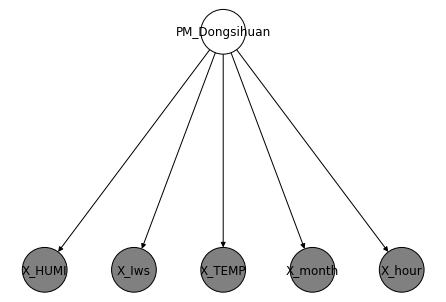

In [95]:
import networkx as nx
    
g = nx.DiGraph()
g.add_edges_from([("PM_Dongsihuan", "X_HUMI"), ("PM_Dongsihuan", "X_Iws"), ("PM_Dongsihuan", "X_TEMP"), ("PM_Dongsihuan", "X_month"), ("PM_Dongsihuan", "X_hour")])

nx.draw(
    g, 
    with_labels=True, 
    node_color=["gray" if "X" in v else "white" for v in g.nodes()],
    pos={"PM_Dongsihuan": (0, 0), "X_HUMI": (-2, -1), "X_Iws": (-1, -1),"X_TEMP": (0, -1), "X_month": (1, -1), "X_hour": (2, -1)},
    edgecolors="black",
    node_size=2000,
)

### wybór zmiennej zależnej i niezależnej
 
### podzielić zmienne ciągłe na dyskretne za pomocą binów
 
### predykcja dla modelu
 
### 
 